<a href="https://colab.research.google.com/github/youbodib/TP_Convolution_IMG/blob/main/TP_Convolution_IMG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Image factice créée : ./test_image.jpg
Type image chargée (gris) : gray
Type image chargée (RGB) : rgb
Application des filtres sur image grise...
Application des filtres sur image RGB...
Images filtrées sauvegardées dans le dossier 'filtered_images'.
Affichage des résultats...


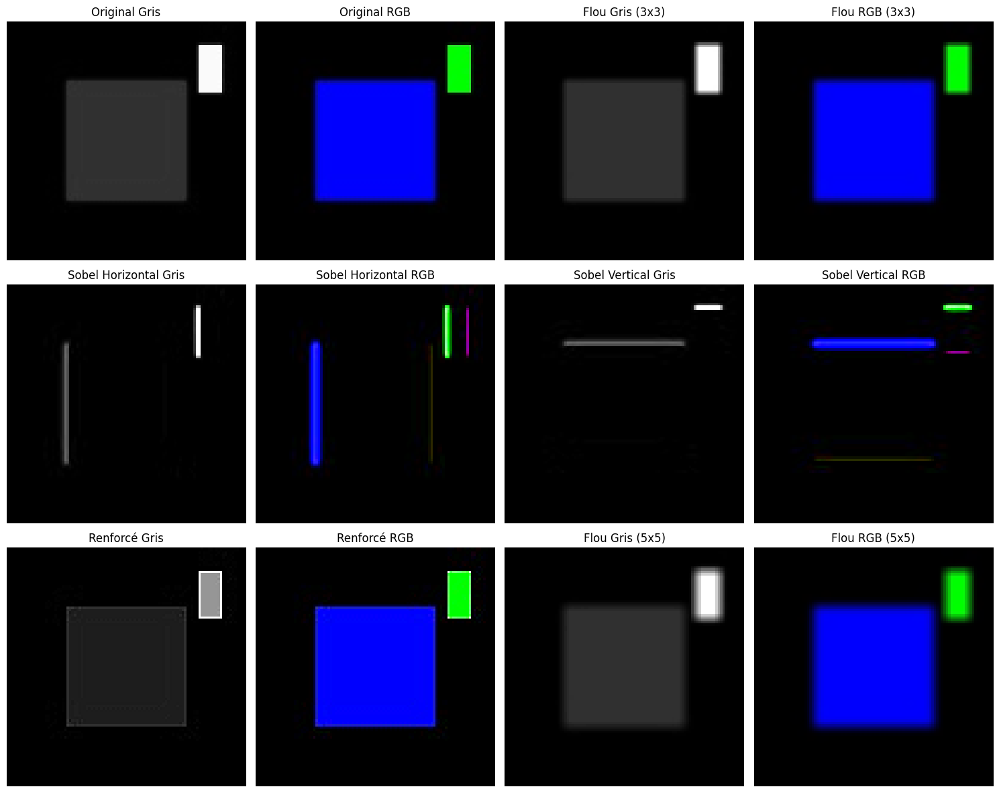

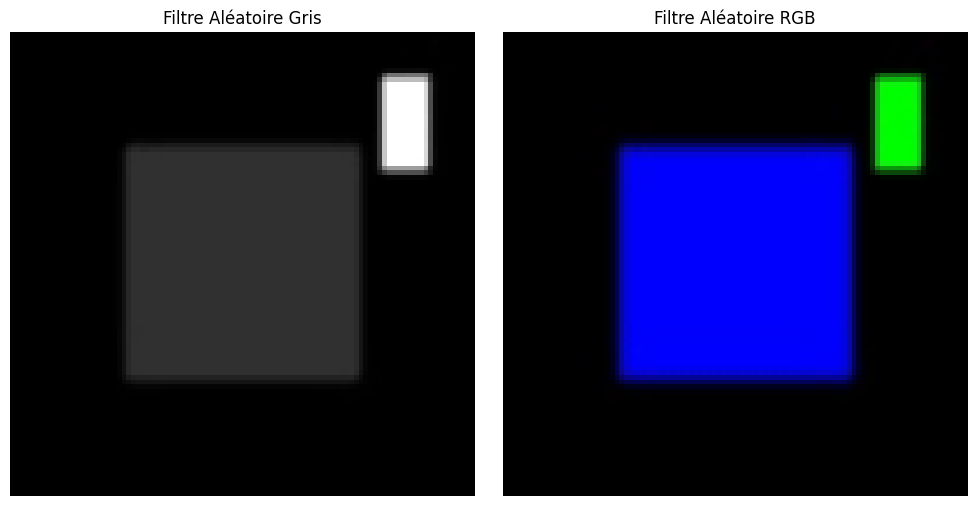

In [ ]:
import numpy as np  # Bibliothèque pour les calculs sur tableaux (images, noyaux)
import cv2  # Bibliothèque OpenCV pour lecture/écriture et traitement d'images
import matplotlib.pyplot as plt  # Pour afficher les images dans une fenêtre graphique
import os  # Pour manipuler les chemins de fichiers et dossiers

# 1. Définition de la fonction de convolution
# Cette fonction applique un noyau (filtre) donné sur une image
def apply_convolution(image, kernel):
    # Vérifications des types et formats des entrées
    assert isinstance(image, np.ndarray), "L'image doit être un tableau NumPy"
    assert isinstance(kernel, np.ndarray), "Le noyau doit être un tableau NumPy"
    assert len(kernel.shape) == 2, "Le noyau doit être une matrice 2D"
    assert kernel.shape[0] == kernel.shape[1], "Le noyau doit être carré"
    assert kernel.shape[0] % 2 == 1, "Le noyau doit avoir une taille impaire"
    assert len(image.shape) in [2, 3], "L'image doit être en niveaux de gris (2D) ou RGB (3D)"

    if len(image.shape) == 3:  # Cas d'une image couleur (RGB)
        assert image.shape[2] == 3, "L'image RGB doit avoir 3 canaux"
        height, width, channels = image.shape  # Dimensions de l'image
        output = np.zeros_like(image, dtype=np.float32)  # Image de sortie en float pour précision
        for c in range(channels):  # Convolution canal par canal (R, G, B)
            output[:, :, c] = convolve_channel(image[:, :, c], kernel)
    else:  # Cas d'une image en niveaux de gris (2D)
        output = convolve_channel(image, kernel)

    # On s'assure que les valeurs restent entre 0 et 255 (valeurs valides pour pixels)
    return np.clip(output, 0, 255).astype(np.uint8)


# Fonction auxiliaire pour appliquer la convolution sur un seul canal (2D)
def convolve_channel(image_channel, kernel):
    k_height, k_width = kernel.shape  # Taille du noyau
    pad_h = k_height // 2  # Calcul du padding vertical (ex: 1 pour 3x3)
    pad_w = k_width // 2  # Calcul du padding horizontal

    # Ajout de padding autour de l'image (remplissage par 0)
    padded_image = np.pad(image_channel, ((pad_h, pad_h), (pad_w, pad_w)), mode='constant')

    output = np.zeros_like(image_channel, dtype=np.float32)  # Image de sortie

    # Parcours pixel par pixel
    for i in range(image_channel.shape[0]):
        for j in range(image_channel.shape[1]):
            # Application du noyau sur la zone correspondante
            output[i, j] = np.sum(padded_image[i:i+k_height, j:j+k_width] * kernel)

    return output


# 2. Définition des noyaux classiques

# Noyau de flou moyen 3x3
kernel_blur = (1/9) * np.array([[1, 1, 1],
                               [1, 1, 1],
                               [1, 1, 1]])

# Noyau Sobel horizontal pour détection des contours horizontaux
kernel_sobel_h = np.array([[-1, 0, 1],
                           [-2, 0, 2],
                           [-1, 0, 1]])

# Noyau Sobel vertical pour détection des contours verticaux
kernel_sobel_v = np.array([[-1, -2, -1],
                           [0, 0, 0],
                           [1, 2, 1]])

# Noyau pour renforcer les contours (sharpen)
kernel_sharpen = np.array([[0, -1, 0],
                           [-1, 5, -1],
                           [0, -1, 0]])

# Noyau de flou moyen 5x5 (plus doux que le 3x3)
kernel_blur_5x5 = (1/25) * np.ones((5, 5))

# Noyau aléatoire 3x3 normalisé (pour tests)
kernel_random = np.random.rand(3, 3)
kernel_random = kernel_random / np.sum(kernel_random) if np.sum(kernel_random) != 0 else kernel_random


# 3. Fonction de chargement d’image
def image_load(image_path, channel=None):  # channel=None pour détection automatique
    if not os.path.exists(image_path):
        raise FileNotFoundError(f"Image introuvable à l'adresse : {image_path}")

    # Lecture en couleur (BGR par défaut)
    img_color = cv2.imread(image_path, cv2.IMREAD_COLOR)
    if img_color is None:
        raise ValueError(f"Erreur : impossible de charger l'image depuis {image_path}")

    # Vérification si l'image a bien 3 canaux (couleur)
    if len(img_color.shape) == 3 and img_color.shape[2] == 3:
        is_color_image = True
    else:
        is_color_image = False  # Peut être une image en niveaux de gris encodée sur 3 canaux identiques

    if channel == 1:  # Forcer niveau de gris
        gray_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
        return gray_image, "gray"
    elif channel == 3:  # Forcer RGB
        rgb_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)  # Conversion BGR → RGB
        return rgb_image, "rgb"
    else:  # Détection automatique
        if is_color_image:
            # Si tous les canaux sont identiques, l'image est en fait en niveaux de gris
            if np.all(img_color[:, :, 0] == img_color[:, :, 1]) and np.all(img_color[:, :, 0] == img_color[:, :, 2]):
                gray_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
                return gray_image, "gray"
            else:
                rgb_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
                return rgb_image, "rgb"
        else:  # Image probablement en niveaux de gris
            gray_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
            if gray_image is None:
                raise ValueError(f"Erreur : impossible de charger l'image en niveaux de gris depuis {image_path}")
            return gray_image, "gray"


# Bloc principal d'exécution
if __name__ == "__main__":
    # Chemin vers l'image à traiter
    image_directory = './'
    image_filename = 'test_image.jpg'
    image_path = os.path.join(image_directory, image_filename)

    # Si l'image n'existe pas, on crée une image factice avec formes colorées pour tests
    if not os.path.exists(image_path):
        dummy_image = np.zeros((100, 100, 3), dtype=np.uint8)
        dummy_image[25:75, 25:75] = [255, 0, 0]  # Carré rouge
        dummy_image[10:30, 80:90] = [0, 255, 0]  # Rectangle vert
        cv2.imwrite(image_path, dummy_image)
        print(f"Image factice créée : {image_path}")

    # Chargement des images en gris et RGB
    try:
        original_image_gray, type_gray = image_load(image_path, channel=1)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)
    except (FileNotFoundError, ValueError) as e:
        print(e)
        print("Veuillez vérifier que 'test_image.jpg' existe ou modifier la variable image_path.")
        exit()

    print(f"Type image chargée (gris) : {type_gray}")
    print(f"Type image chargée (RGB) : {type_rgb}")

    # Application des filtres sur les images en niveaux de gris
    print("Application des filtres sur image grise...")
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # Application des filtres sur les images RGB
    print("Application des filtres sur image RGB...")
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)

    # Sauvegarde des résultats dans un dossier
    output_dir = 'filtered_images'
    os.makedirs(output_dir, exist_ok=True)  # Création du dossier si nécessaire

    # Sauvegarde des images traitées en niveaux de gris
    cv2.imwrite(os.path.join(output_dir, 'blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'random_filtered_gray.jpg'), random_filtered_gray)

    # Pour les images RGB, OpenCV attend un format BGR pour la sauvegarde, on convertit donc RGB → BGR
    cv2.imwrite(os.path.join(output_dir, 'blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Images filtrées sauvegardées dans le dossier '{output_dir}'.")

    # Affichage des images originales et filtrées
    print("Affichage des résultats...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Images originales
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gris')
    ax[0].axis('off')

    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Flou 3x3
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Flou Gris (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Flou RGB (3x3)')
    ax[3].axis('off')

    # Sobel horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gris')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gris')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Renforcement (sharpen)
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Renforcé Gris')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Renforcé RGB')
    ax[9].axis('off')

    # Flou 5x5
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Flou Gris (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Flou RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Affichage séparé des résultats du filtre aléatoire
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Filtre Aléatoire Gris')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Filtre Aléatoire RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()

✅ Chargé: pepper.ppm | RGB: uint8 | Gray: uint8
📁 Résultats enregistrés dans 'filtered_images_pepper'.


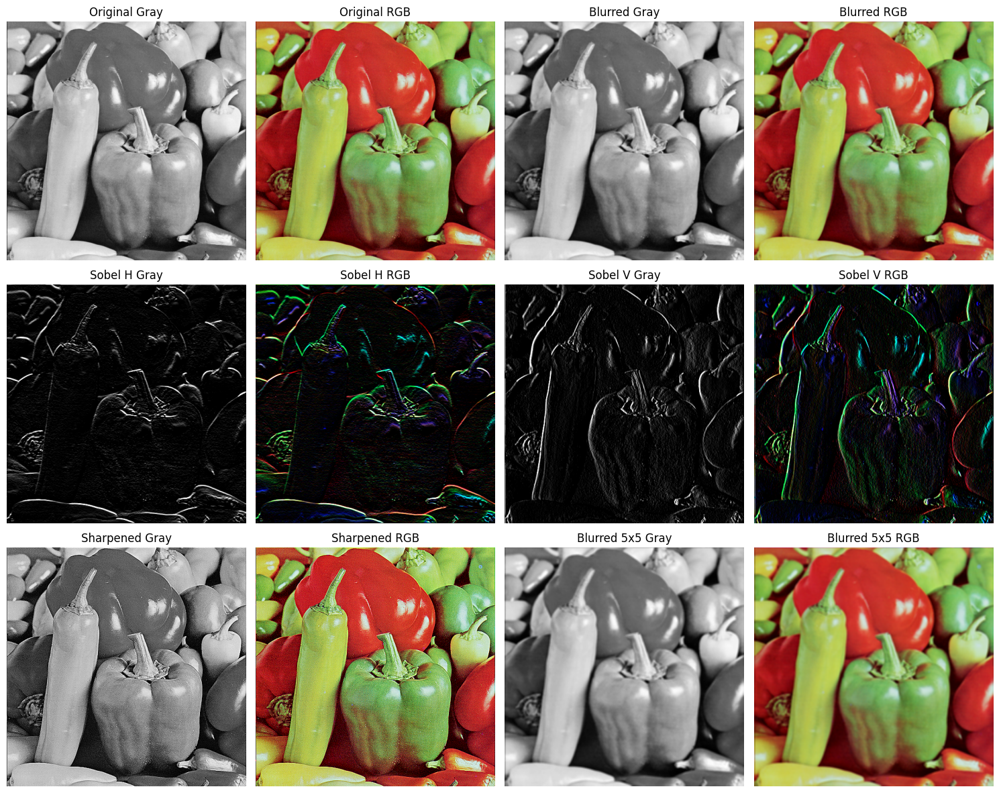

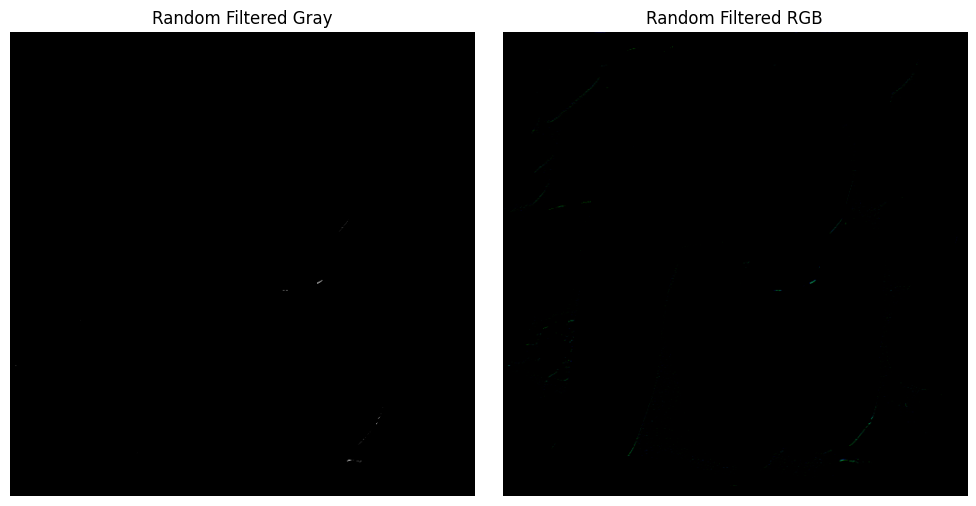

✅ Chargé: Boats.ppm | RGB: uint8 | Gray: uint8
📁 Résultats enregistrés dans 'filtered_images_Boats'.


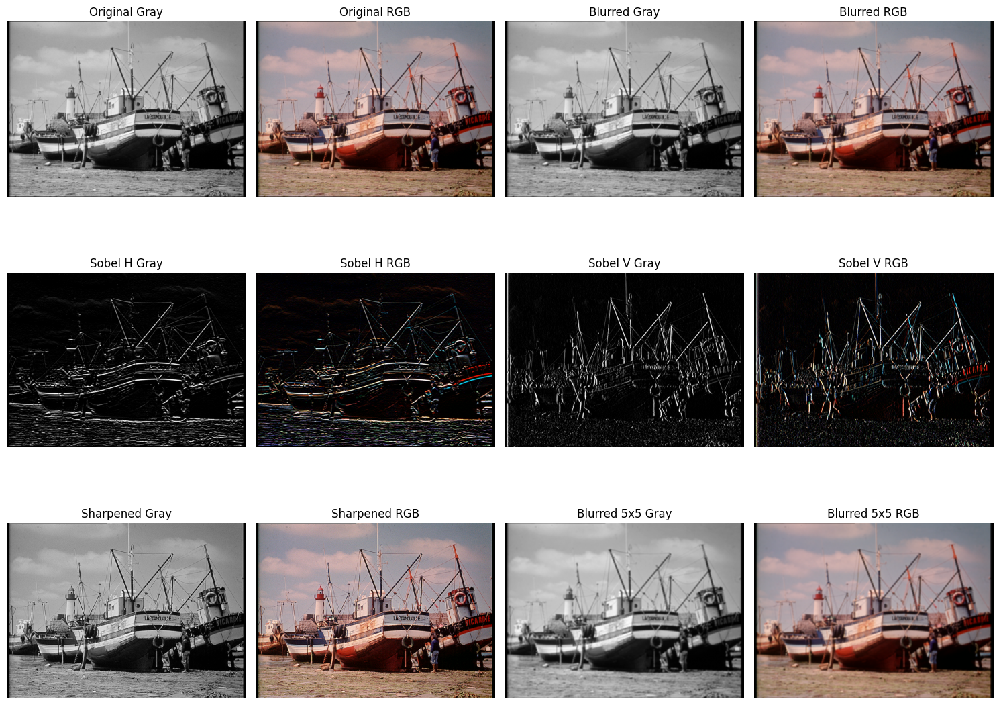

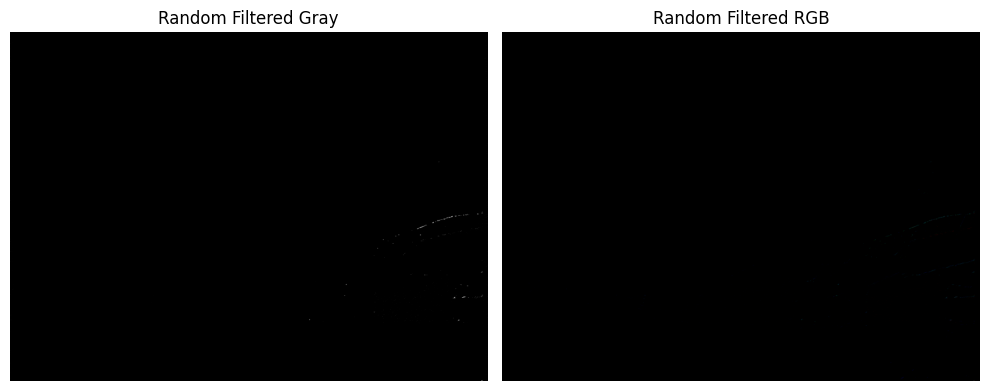

✅ Chargé: baboon.ppm | RGB: uint8 | Gray: uint8
📁 Résultats enregistrés dans 'filtered_images_baboon'.


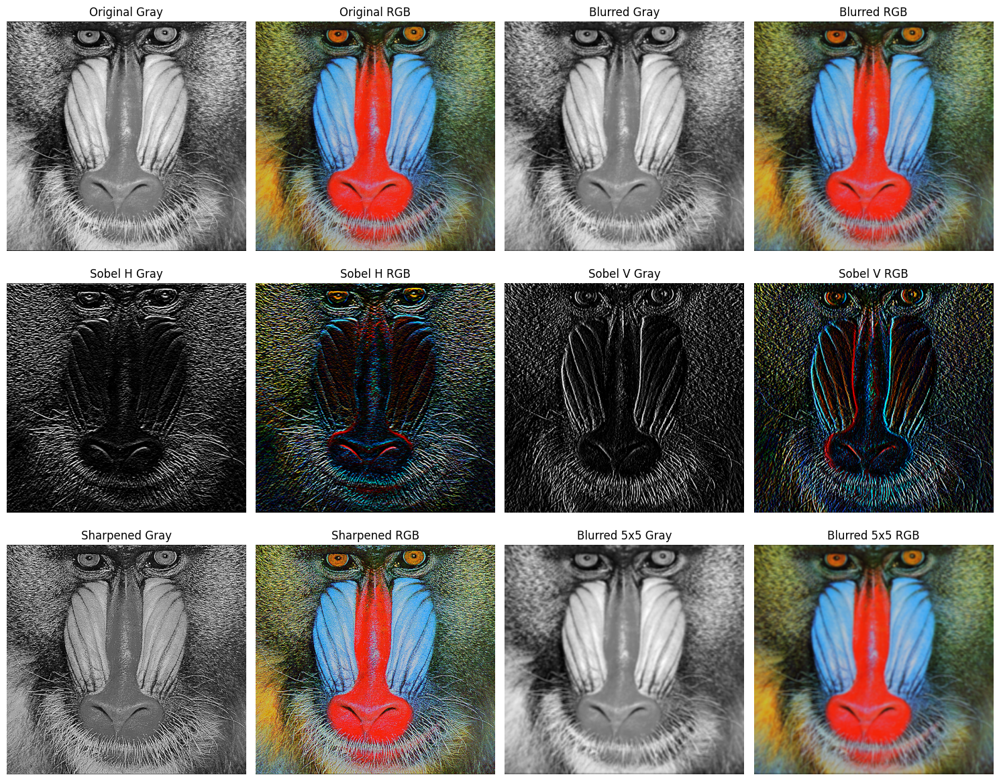

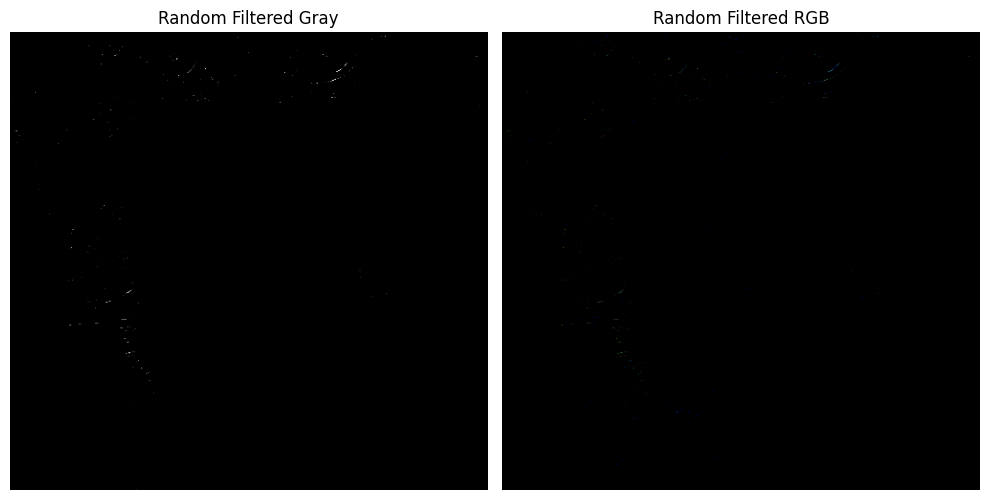

✅ Chargé: airplane.ppm | RGB: uint8 | Gray: uint8
📁 Résultats enregistrés dans 'filtered_images_airplane'.


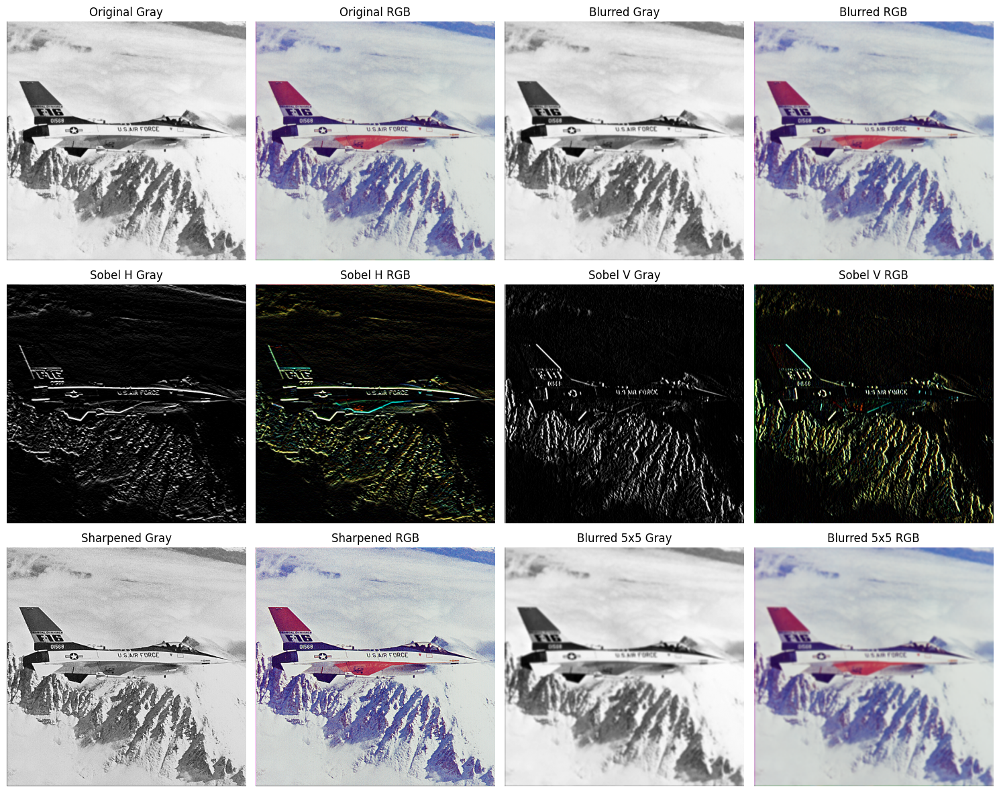

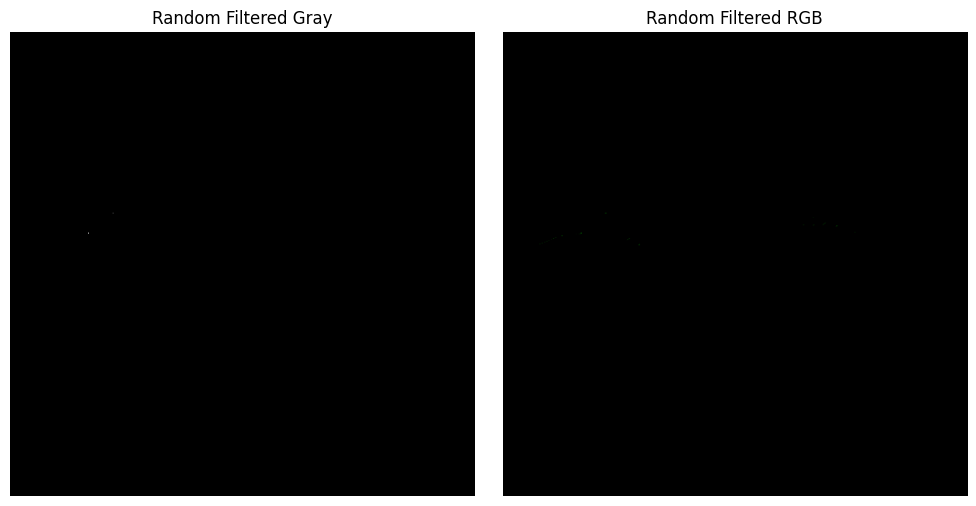

✅ Chargé: barbara.ppm | RGB: uint8 | Gray: uint8
📁 Résultats enregistrés dans 'filtered_images_barbara'.


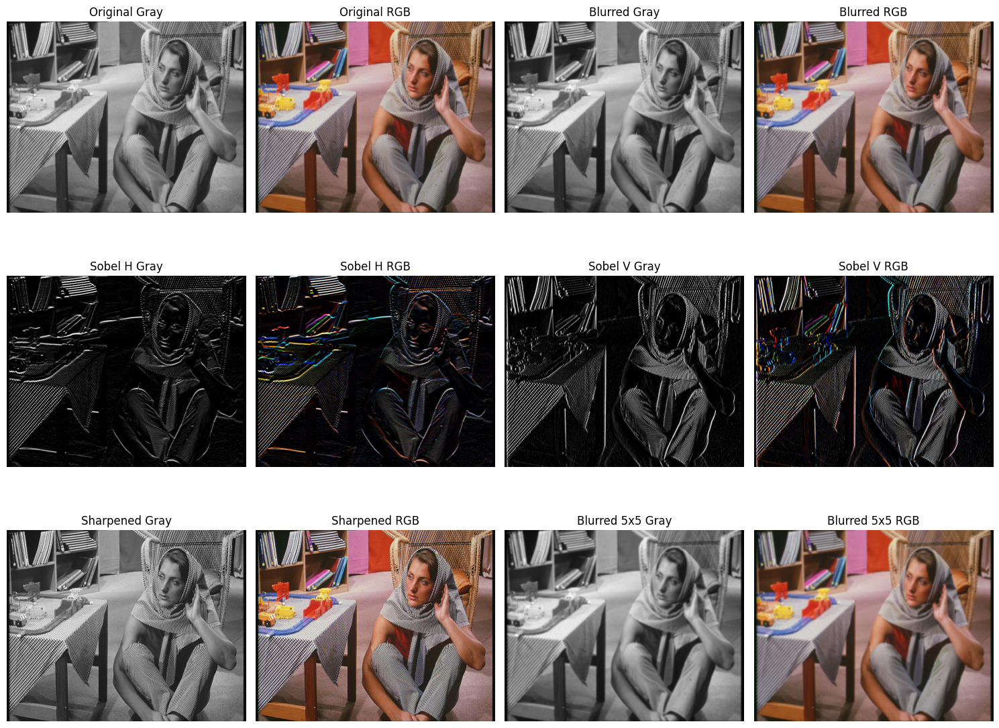

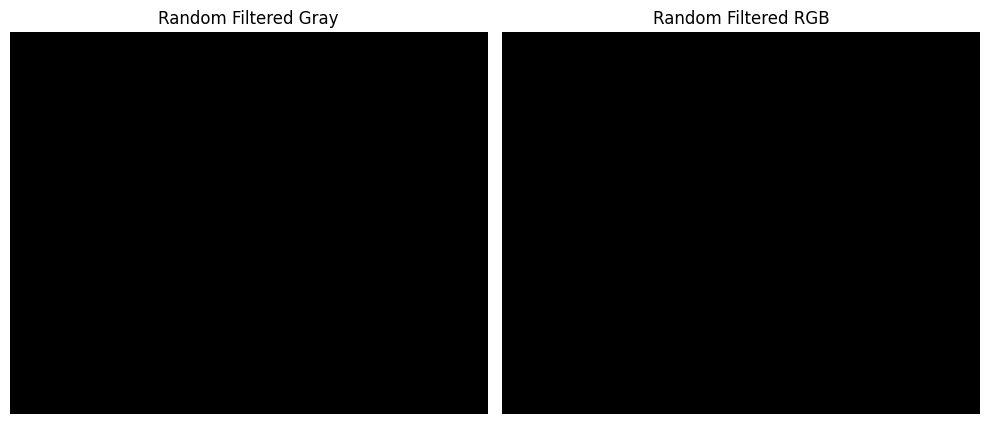

✅ Chargé: lenna.ppm | RGB: uint8 | Gray: uint8
📁 Résultats enregistrés dans 'filtered_images_lenna'.


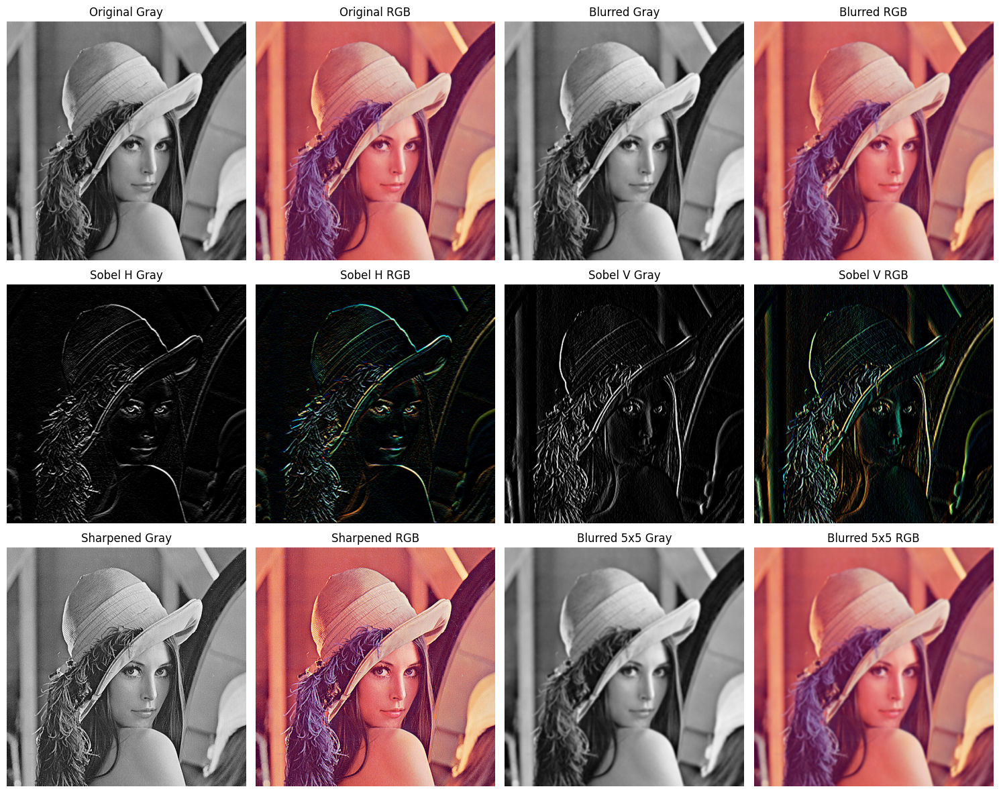

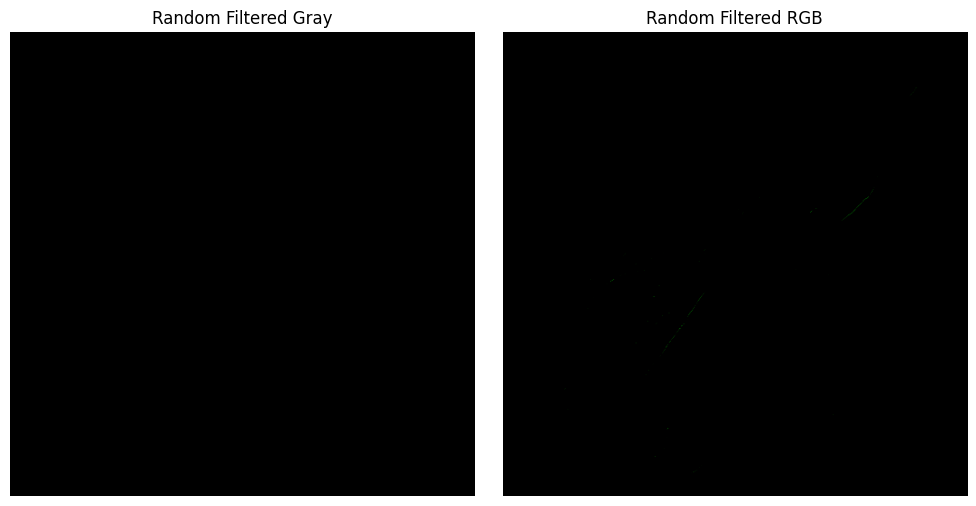

✅ Chargé: goldhill.ppm | RGB: uint8 | Gray: uint8
📁 Résultats enregistrés dans 'filtered_images_goldhill'.


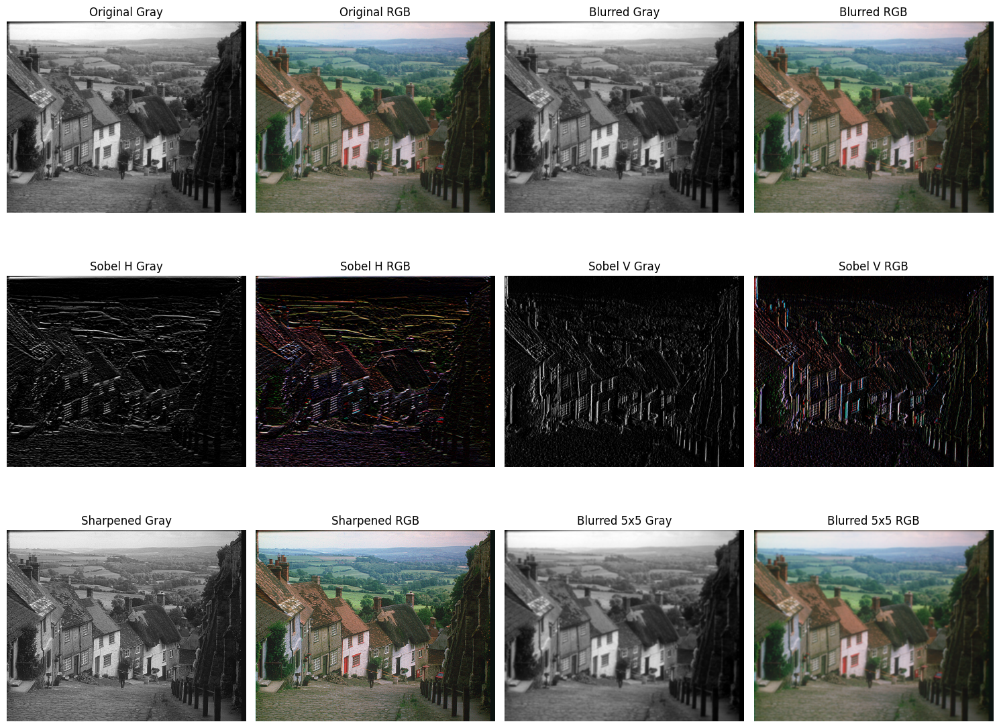

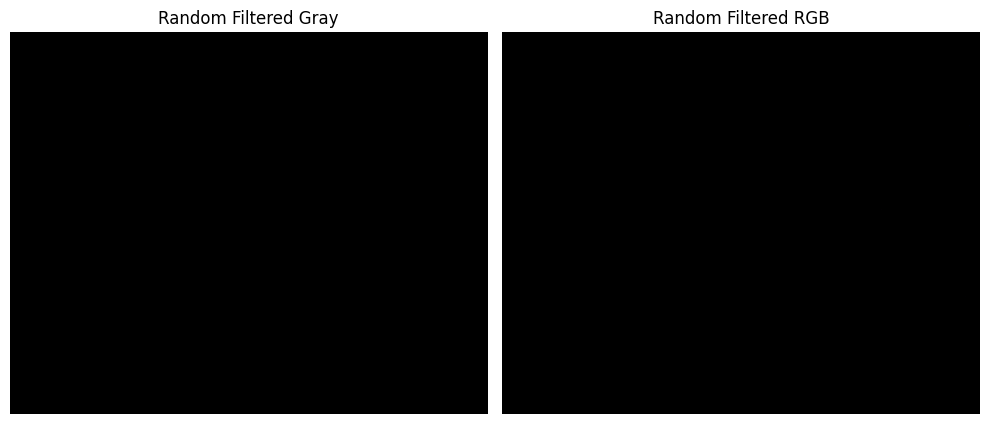

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# === Définition des noyaux de convolution ===
kernel_blur = np.ones((3, 3), np.float32) / 9
kernel_blur_5x5 = np.ones((5, 5), np.float32) / 25
kernel_sobel_h = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]], dtype=np.float32)
kernel_sobel_v = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], dtype=np.float32)
kernel_sharpen = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]], dtype=np.float32)
kernel_random = np.random.uniform(-1, 1, (3, 3)).astype(np.float32)

# === Fonctions utilitaires ===
def image_load(path, channel=3):
    img = cv2.imread(path, cv2.IMREAD_COLOR if channel == 3 else cv2.IMREAD_GRAYSCALE)
    if img is None:
        raise FileNotFoundError(f"Image not found at {path}")
    if channel == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    return img, str(img.dtype)

def apply_convolution(image, kernel):
    if len(image.shape) == 2:  # grayscale
        return cv2.filter2D(image, -1, kernel)
    elif len(image.shape) == 3:  # RGB
        channels = cv2.split(image)
        filtered_channels = [cv2.filter2D(c, -1, kernel) for c in channels]
        return cv2.merge(filtered_channels)

# === Traitement principal ===
if __name__ == "__main__":
    images = ['pepper', 'Boats', 'baboon', 'airplane', 'barbara', 'lenna', 'goldhill']  # Noms de fichiers sans extension

    for name in images:
        image_filename = f"{name}.ppm"
        image_path = os.path.join('./', image_filename)

        if not os.path.exists(image_path):
            print(f"⚠️ Fichier '{image_filename}' non trouvé.")
            continue

        try:
            original_rgb, type_rgb = image_load(image_path, channel=3)
            original_gray, type_gray = image_load(image_path, channel=1)
        except Exception as e:
            print(f"❌ Erreur de chargement de l’image {name}: {e}")
            continue

        print(f"✅ Chargé: {image_filename} | RGB: {type_rgb} | Gray: {type_gray}")

        # === Application des filtres ===
        filters_gray = {
            "blurred": apply_convolution(original_gray, kernel_blur),
            "sobel_h": apply_convolution(original_gray, kernel_sobel_h),
            "sobel_v": apply_convolution(original_gray, kernel_sobel_v),
            "sharpened": apply_convolution(original_gray, kernel_sharpen),
            "blurred_5x5": apply_convolution(original_gray, kernel_blur_5x5),
            "random_filtered": apply_convolution(original_gray, kernel_random)
        }

        filters_rgb = {
            "blurred": apply_convolution(original_rgb, kernel_blur),
            "sobel_h": apply_convolution(original_rgb, kernel_sobel_h),
            "sobel_v": apply_convolution(original_rgb, kernel_sobel_v),
            "sharpened": apply_convolution(original_rgb, kernel_sharpen),
            "blurred_5x5": apply_convolution(original_rgb, kernel_blur_5x5),
            "random_filtered": apply_convolution(original_rgb, kernel_random)
        }

        # === Sauvegarde des résultats ===
        output_dir = f"filtered_images_{name}"
        os.makedirs(output_dir, exist_ok=True)

        for key, img in filters_gray.items():
            cv2.imwrite(os.path.join(output_dir, f"{name}_{key}_gray.jpg"), img)

        for key, img in filters_rgb.items():
            bgr = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
            cv2.imwrite(os.path.join(output_dir, f"{name}_{key}_rgb.jpg"), bgr)

        print(f"📁 Résultats enregistrés dans '{output_dir}'.")

        # === Affichage des résultats ===
        fig, ax = plt.subplots(3, 4, figsize=(15, 12))
        axes = ax.ravel()

        axes[0].imshow(original_gray, cmap='gray')
        axes[0].set_title('Original Gray')
        axes[1].imshow(original_rgb)
        axes[1].set_title('Original RGB')
        axes[2].imshow(filters_gray['blurred'], cmap='gray')
        axes[2].set_title('Blurred Gray')
        axes[3].imshow(filters_rgb['blurred'])
        axes[3].set_title('Blurred RGB')
        axes[4].imshow(filters_gray['sobel_h'], cmap='gray')
        axes[4].set_title('Sobel H Gray')
        axes[5].imshow(filters_rgb['sobel_h'])
        axes[5].set_title('Sobel H RGB')
        axes[6].imshow(filters_gray['sobel_v'], cmap='gray')
        axes[6].set_title('Sobel V Gray')
        axes[7].imshow(filters_rgb['sobel_v'])
        axes[7].set_title('Sobel V RGB')
        axes[8].imshow(filters_gray['sharpened'], cmap='gray')
        axes[8].set_title('Sharpened Gray')
        axes[9].imshow(filters_rgb['sharpened'])
        axes[9].set_title('Sharpened RGB')
        axes[10].imshow(filters_gray['blurred_5x5'], cmap='gray')
        axes[10].set_title('Blurred 5x5 Gray')
        axes[11].imshow(filters_rgb['blurred_5x5'])
        axes[11].set_title('Blurred 5x5 RGB')

        for a in axes:
            a.axis('off')
        plt.tight_layout()
        plt.show()

        # Affichage séparé des filtres aléatoires
        fig_random, ax_random = plt.subplots(1, 2, figsize=(10, 5))
        ax_random[0].imshow(filters_gray['random_filtered'], cmap='gray')
        ax_random[0].set_title('Random Filtered Gray')
        ax_random[0].axis('off')
        ax_random[1].imshow(filters_rgb['random_filtered'])
        ax_random[1].set_title('Random Filtered RGB')
        ax_random[1].axis('off')
        plt.tight_layout()
        plt.show()